Проект: «Поиск изображений по запросу»

Цель: научить модель выдавать релевантность «текст ↔ изображение» (0–1).

Данные:

/datasets/image_search/train_dataset.csv + папка train_images/ (изображение ↔ до 5 описаний).

Аннотации краудсорсинга (CrowdAnnotations.tsv) и экспертов (ExpertAnnotations.tsv) для обучения.

Тест: test_queries.csv + папка test_images/.

Задачи:

Подготовить пары «картинка – текст» и метки релевантности.

Обучить двойную модель (image encoder + text encoder) с сигмоидой на выходе.

Оценить качество на тесте.

## 1. Исследовательский анализ данных

Наш датасет содержит экспертные и краудсорсинговые оценки соответствия текста и изображения.

В файле с экспертными мнениями для каждой пары изображение-текст имеются оценки от трёх специалистов. Для решения задачи вы должны эти оценки агрегировать — превратить в одну. Существует несколько способов агрегации оценок, самый простой — голосование большинства: за какую оценку проголосовала большая часть экспертов (в нашем случае 2 или 3), та оценка и ставится как итоговая. Поскольку число экспертов меньше числа классов, может случиться, что каждый эксперт поставит разные оценки, например: 1, 4, 2. В таком случае данную пару изображение-текст можно исключить из датасета.

Вы можете воспользоваться другим методом агрегации оценок или придумать свой.

В файле с краудсорсинговыми оценками информация расположена в таком порядке:

1. Доля исполнителей, подтвердивших, что текст **соответствует** картинке.
2. Количество исполнителей, подтвердивших, что текст **соответствует** картинке.
3. Количество исполнителей, подтвердивших, что текст **не соответствует** картинке.

После анализа экспертных и краудсорсинговых оценок выберите либо одну из них, либо объедините их в одну по какому-то критерию: например, оценка эксперта принимается с коэффициентом 0.6, а крауда — с коэффициентом 0.4.

Ваша модель должна возвращать на выходе вероятность соответствия изображения тексту, поэтому целевая переменная должна иметь значения от 0 до 1.


In [ ]:
!pip install torchvision -q
!pip install tqdm -q
!pip install transformers -q
!pip install catboost -q

In [ ]:
import pandas as pd
from matplotlib import image as mpimg
import torch
from torchvision import datasets, transforms
from torchvision.utils import make_grid
from PIL import Image
import requests
from io import BytesIO
from torch.utils.data import Dataset, DataLoader
import matplotlib.pyplot as plt
import os
import torch.nn as nn
import tqdm
from transformers import DistilBertTokenizer, DistilBertModel
from transformers import ViTImageProcessor, ViTForImageClassification
from transformers import CLIPVisionModel
from sklearn.metrics.pairwise import cosine_similarity
from transformers import AutoTokenizer, CLIPTextModel
import torchvision.models as models
import numpy as np
from sklearn.model_selection import GroupShuffleSplit
from transformers import CLIPProcessor, CLIPModel
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error
from transformers import AutoProcessor, AutoModelForZeroShotImageClassification
import catboost

2024-04-14 11:52:41.117662: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-04-14 11:52:41.117755: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-04-14 11:52:41.265500: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


In [ ]:
DIRECTORY = '/kaggle/input/text-to-img/to_upload/'
SAVE_DIRECTORY = '/kaggle/working/'
IMAGE_URL = "http://salasardyechem.com/img/not-available.jpg"

In [ ]:
exp_anot = pd.read_csv(os.path.join(DIRECTORY, 'ExpertAnnotations.tsv'), sep="\t", header=None, names=["image", "query_id", 'expert_1', 'expert_2', 'expert_3'])
crw_anot = pd.read_csv(os.path.join(DIRECTORY, 'CrowdAnnotations.tsv'), sep="\t", header=None, names=["image", "query_id", 'ratio_1', 'is_1', 'is_0'])
train_set = pd.read_csv(os.path.join(DIRECTORY, 'train_dataset.csv'))
test_set = pd.read_csv(os.path.join(DIRECTORY, 'test_images.csv'))
test_queries = pd.read_csv(os.path.join(DIRECTORY, 'test_queries.csv'), sep='|', index_col=0)

Посмотрим чем отличается датасет с оценками экспертов и краудфандинга

In [ ]:
exp_anot['image'].value_counts()

image
754852108_72f80d421f.jpg     10
1339596997_8ac29c1841.jpg    10
488356951_b3b77ad832.jpg     10
279728508_6bd7281f3c.jpg     10
2061354254_faa5bd294b.jpg    10
                             ..
3227148358_f152303584.jpg     2
241346971_c100650320.jpg      2
2914206497_5e36ac6324.jpg     2
3239021459_a6b71bb400.jpg     2
3591462960_86045906bd.jpg     2
Name: count, Length: 1000, dtype: int64

In [ ]:
crw_anot['image'].value_counts()

image
1572532018_64c030c974.jpg    120
3250695024_93e8ab7305.jpg    110
324208502_674488bcea.jpg     100
3359551687_68f2f0212a.jpg    100
3647750811_395fbd397e.jpg    100
                            ... 
2914206497_5e36ac6324.jpg     10
363617160_6cb0c723be.jpg      10
3567061016_62768dcce1.jpg     10
3578841731_f775cab089.jpg     10
3449114979_6cdc3e8da8.jpg     10
Name: count, Length: 1000, dtype: int64

В оценках краудфандинга намного больше оценок и больше описаний для каждого изображения.

In [ ]:
crw_anot.shape

(47830, 5)

In [ ]:
exp_anot.shape

(5822, 5)

Краудфандинговых оценок в ~9 раз больше экспертных.

In [ ]:
crw_anot['image'].unique().shape

(1000,)

In [ ]:
exp_anot['image'].unique().shape

(1000,)

В обоих датасетах 1000 изображений.

In [ ]:
len(os.listdir(os.path.join(DIRECTORY, 'train_images/')))

1000

Всего изображений 1000, следовательно в обоих датасетах есть оценка для каждой фотографии, просто возможных описаний в оценках краудфандинга больше. Посмотрим сколько изображений в тестовом датасета:

In [ ]:
len(os.listdir(os.path.join(DIRECTORY, 'test_images/')))

100

В тестовом датасете у нас 100 изображений. Ознакомимся с тренировочным датасетом.

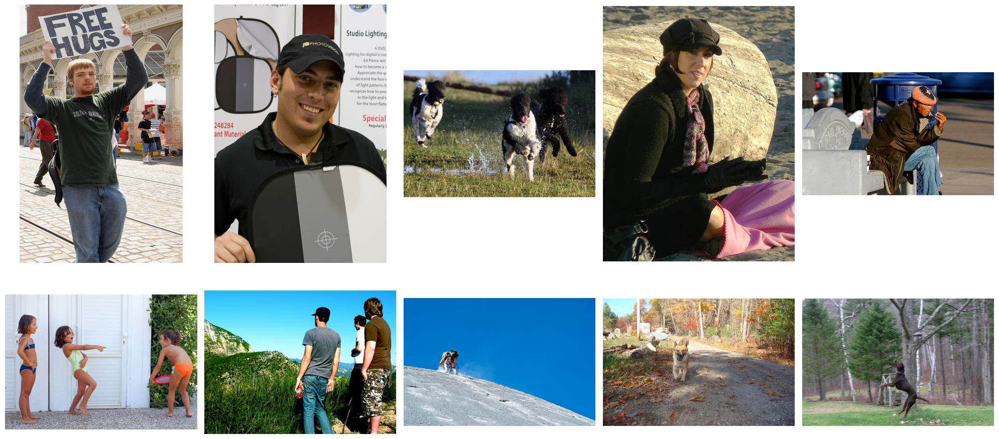

In [ ]:
def view_imgs(files, frame):
    image_files = np.array(DIRECTORY + files + frame['image'].sample(10, random_state=2))


    num_rows = 2
    num_cols = 5

    fig, axes = plt.subplots(num_rows, num_cols, figsize=(20, 10))

    axes = axes.flatten()

    for ax, img_path in zip(axes, image_files):
        image = mpimg.imread(img_path)
        ax.imshow(image)
        ax.axis('off')

    plt.tight_layout()
    plt.show()

view_imgs('train_images/', train_set)

Фотографии разных размеров, а также фотографии детей, что нам не подходит. Проверим есть ли фотографии детей в тестовом датасете:

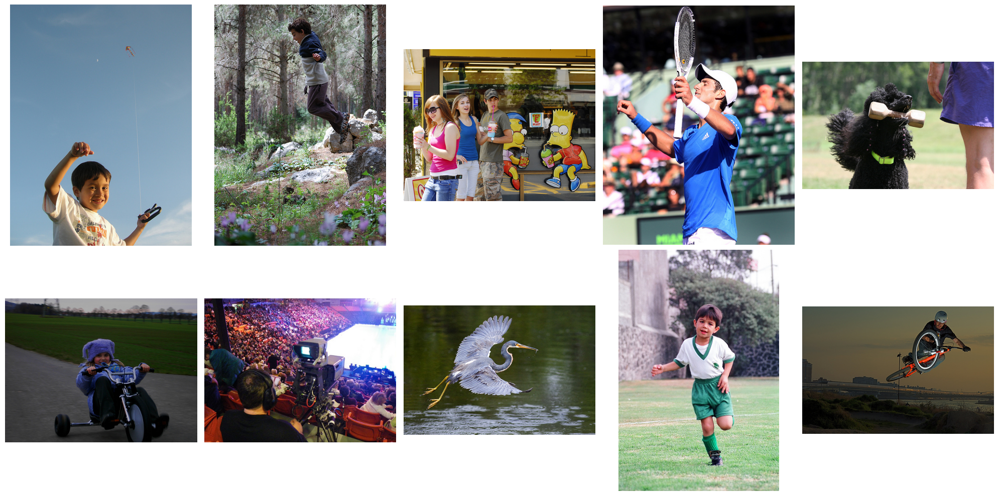

In [ ]:
view_imgs('test_images/', test_set)

Здесь они тоже есть.

#### Вывод по ознакомлению с данными
Нам дано 1000 изображений для тренировки и 100 для теста. Имеются готовые оценки описаний от экспертов и от краудфандинга, от краудфандинга оценок описаний в разы больше, хотя оцениваются те же 1000 изображений. На изображениях есть дети, как на тренировочной, так и на тестовой выборке, эти изображения придется удалить.

### Предобработка данных.

Так как нам известно, что оценки экспертов могут не совпадать, поэтому исключим все строки, где мнение разнится.

In [ ]:
exp_anot = exp_anot.query('not ((expert_1 != expert_2) and (expert_2 != expert_3) and (expert_1 != expert_3))')

Напишем функцию, для оценки вероятности совпадение картинки с описанием.

In [ ]:
def find_majority(row):
    counts = pd.Series([row['expert_1'], row['expert_2'], row['expert_3']]).value_counts()

    if counts.idxmax() == 1:
        return 0
    elif counts.idxmax() == 4:
        return 1
    elif counts.idxmax() == 2:
        return 1/3
    elif counts.idxmax() == 3:
        return 2/3

exp_anot['final'] = exp_anot.apply(find_majority, axis=1)

<img src="https://emojigraph.org/media/apple/check-mark-button_2705.png" align=left width=33, heigth=33>
<div class="alert alert-success">
При предобработке датафреймов старайся по возможности использовать векторные операции и встроенные инструменты языка.
    
Давай замерим скорость выполнение двух вариантов. Я немного переписал твой код, и взял медианну для поиска самого частой оценки (если две оценки из трех одинаковы, то медианна и мода совпадут), а также использовал линейное преобразование (x-1)/3, которое легко векторизуется.
    
Разница в скорости работы - 400 раз. Да, это может быть незаметно для маленького датафрейма, однако это может быть критично при работе с большими объемами данных.
    
![image.png](attachment:image.png)    
    
    
    
</div>

In [ ]:
exp_anot.head(20)

,image,query_id,expert_1,expert_2,expert_3,final
0,1056338697_4f7d7ce270.jpg,2549968784_39bfbe44f9.jpg#2,1,1,1,0.000000
1,1056338697_4f7d7ce270.jpg,2718495608_d8533e3ac5.jpg#2,1,1,2,0.000000
2,1056338697_4f7d7ce270.jpg,3181701312_70a379ab6e.jpg#2,1,1,2,0.000000
3,1056338697_4f7d7ce270.jpg,3207358897_bfa61fa3c6.jpg#2,1,2,2,0.333333
4,1056338697_4f7d7ce270.jpg,3286822339_5535af6b93.jpg#2,1,1,2,0.000000
5,1056338697_4f7d7ce270.jpg,3360930596_1e75164ce6.jpg#2,1,1,1,0.000000
6,1056338697_4f7d7ce270.jpg,3545652636_0746537307.jpg#2,1,1,1,0.000000
7,1056338697_4f7d7ce270.jpg,434792818_56375e203f.jpg#2,1,1,2,0.000000
8,106490881_5a2dd9b7bd.jpg,1425069308_488e5fcf9d.jpg#2,1,1,1,0.000000
9,106490881_5a2dd9b7bd.jpg,1714316707_8bbaa2a2ba.jpg#2,2,2,2,0.333333


Объединим оценки экспертов и краудфандинга в одну таблицу через OUTER JOIN, чтобы не терять лишнию информацию.

In [ ]:
annot = exp_anot.merge(crw_anot, how='outer').drop(columns=['expert_1', 'expert_2', 'expert_3', 'is_1', 'is_0'])
annot.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 51268 entries, 0 to 51267
Data columns (total 4 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   image     51268 non-null  object 
 1   query_id  51268 non-null  object 
 2   final     5696 non-null   float64
 3   ratio_1   47830 non-null  float64
dtypes: float64(2), object(2)
memory usage: 1.6+ MB


In [ ]:
annot.head()

,image,query_id,final,ratio_1
0,1056338697_4f7d7ce270.jpg,1056338697_4f7d7ce270.jpg#2,NaN,1.0
1,1056338697_4f7d7ce270.jpg,114051287_dd85625a04.jpg#2,NaN,0.0
2,1056338697_4f7d7ce270.jpg,1427391496_ea512cbe7f.jpg#2,NaN,0.0
3,1056338697_4f7d7ce270.jpg,2073964624_52da3a0fc4.jpg#2,NaN,0.0
4,1056338697_4f7d7ce270.jpg,2083434441_a93bc6306b.jpg#2,NaN,0.0


Так как оценок экспертов у нас в 10 раз меньше, то столбец с оценками экспертов состоит на 90% из пропусков.

Первостепенную важность имеют оценки экспертов, но так как их в разы меньше, то если оценок эксперта нет, ставим оценку краудфандинга.

In [ ]:
annot.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 51268 entries, 0 to 51267
Data columns (total 4 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   image     51268 non-null  object 
 1   query_id  51268 non-null  object 
 2   final     5696 non-null   float64
 3   ratio_1   47830 non-null  float64
dtypes: float64(2), object(2)
memory usage: 1.6+ MB


In [ ]:
# def score(row):
#     if pd.notna(row['final']):
#         return row['final']
#     else:
#         return row['ratio_1']

# annot['metric'] = annot.apply(score, axis=1)
annot['metric'] = annot['final']
annot['metric'] = annot['metric'].fillna(annot['ratio_1'])

In [ ]:
annot = annot.drop(columns=['final', 'ratio_1'])

In [ ]:
annot.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 51268 entries, 0 to 51267
Data columns (total 3 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   image     51268 non-null  object 
 1   query_id  51268 non-null  object 
 2   metric    51268 non-null  float64
dtypes: float64(1), object(2)
memory usage: 1.2+ MB


In [ ]:
train_set.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5822 entries, 0 to 5821
Data columns (total 3 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   image       5822 non-null   object
 1   query_id    5822 non-null   object
 2   query_text  5822 non-null   object
dtypes: object(3)
memory usage: 136.6+ KB


In [ ]:
train_set.head(10)

,image,query_id,query_text
0,1056338697_4f7d7ce270.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
1,1262583859_653f1469a9.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
2,2447284966_d6bbdb4b6e.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
3,2549968784_39bfbe44f9.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
4,2621415349_ef1a7e73be.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
5,3030566410_393c36a6c5.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
6,3155451946_c0862c70cb.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
7,3222041930_f642f49d28.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
8,343218198_1ca90e0734.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
9,3718964174_cb2dc1615e.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...


Теперь объединим оценки и описания в одну таблицу.

In [ ]:
train_set = train_set.merge(annot, how='inner')

In [ ]:
train_set.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5767 entries, 0 to 5766
Data columns (total 4 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   image       5767 non-null   object 
 1   query_id    5767 non-null   object 
 2   query_text  5767 non-null   object 
 3   metric      5767 non-null   float64
dtypes: float64(1), object(3)
memory usage: 180.3+ KB


In [ ]:
train_set.head()

,image,query_id,query_text,metric
0,1056338697_4f7d7ce270.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...,0.000000
1,1262583859_653f1469a9.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...,0.000000
2,2447284966_d6bbdb4b6e.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...,0.333333
3,2549968784_39bfbe44f9.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...,1.000000
4,2621415349_ef1a7e73be.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...,0.000000


Объединил и получили необходимые оценки.

In [ ]:
class OwnDataset(Dataset):
    def __init__(self, img_paths, labels, transform=None):
        self.img_paths = img_paths
        self.labels = labels
        self.transform = transform

    def __len__(self):
        return len(self.img_paths)

    def __getitem__(self, index):
        img = Image.open(self.img_paths[index]).convert('RGB')

        if self.transform:
            img = self.transform(img)

        label = self.labels[index]
        return img, label

transform = transforms.Compose([
    transforms.ToTensor()
])


# Для примера возьмем 10 рандомных картинок и описаний к ним, выберем те, где описание картинки и картинка
# соотвутствуют друг другу  хотя бы на половину.
train_dataset = train_set[train_set['metric'] > 0.5].sample(10)







Далее возьмем из этих описаний изображения к ним.

In [ ]:
img_paths = []
labels = []
for i in range(len(train_dataset)):
    curr = list(train_dataset["image"])[i]
    img_paths.append(DIRECTORY + 'train_images/' + curr)
    labels.append(list(train_dataset["query_text"])[i])

Выведим их, используем collate_fn, чтобы создать даталоадер с разными размерами изображений.

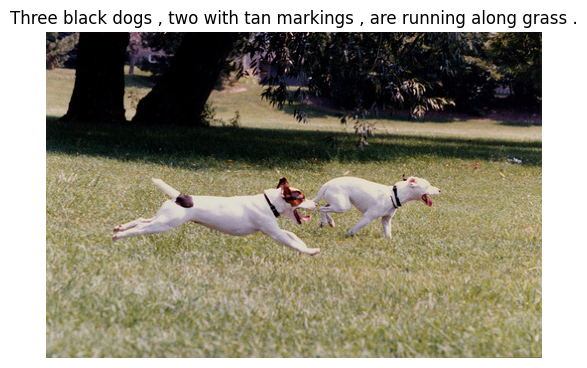

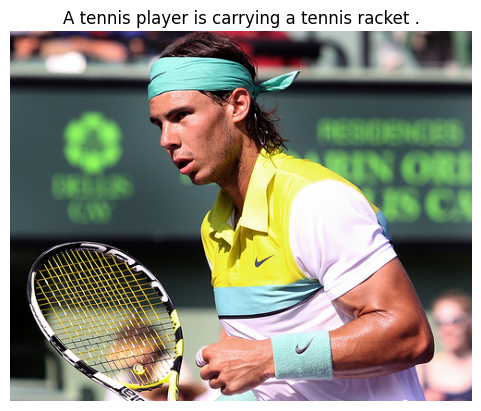

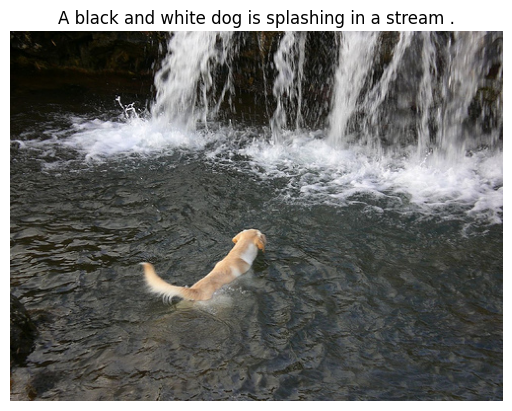

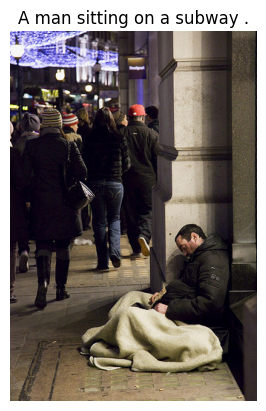

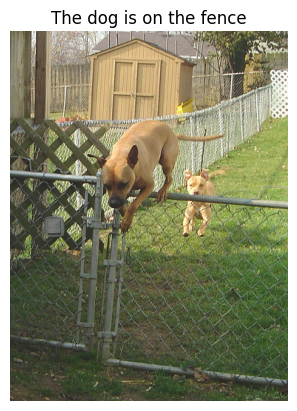

In [ ]:
custom_dataset = OwnDataset(img_paths, labels, transform=transform)

def my_collate(batch):
    images = [item[0] for item in batch]
    labels = [item[1] for item in batch]
    return images, labels

data_loader = DataLoader(custom_dataset, batch_size=10, shuffle=True, collate_fn=my_collate)

images, labels = next(iter(data_loader))

for image, label in zip(images, labels):
    plt.imshow(image.permute(1, 2, 0))
    plt.title(label)
    plt.axis('off')
    plt.show()


In [ ]:
train_dataset['image'].value_counts()

#### Вывод по разделу
В рамках исследования проверили три таблицы, из чего выяснили что оценок экспертов в десять раз меньше чем краудфандинговых, из-за чего пришлось сокращать выборку. Изображения в целом соответствуют описанию (напомню что на одну картинку примерно приходится меньше 5 описаний). Удалили несовпадающие оценки экспертов.

## 2. Проверка данных

В некоторых странах, где работает ваша компания, действуют ограничения по обработке изображений: поисковым сервисам и сервисам, предоставляющим возможность поиска, запрещено без разрешения родителей или законных представителей предоставлять любую информацию, в том числе, но не исключительно тексты, изображения, видео и аудио, содержащие описание, изображение или запись голоса детей. Ребёнком считается любой человек, не достигший 16 лет.

В вашем сервисе строго следуют законам стран, в которых работают. Поэтому при попытке посмотреть изображения, запрещённые законодательством, вместо картинок показывается дисклеймер:

> This image is unavailable in your country in compliance with local laws
>

Однако у вас в PoC нет возможности воспользоваться данным функционалом. Поэтому все изображения, которые нарушают данный закон, нужно удалить из обучающей выборки.

Соберем потенциальные слова, говорящие о подростках и удалим их.

In [ ]:
minor_keywords = [
    "child", "kid", "toddler", "infant", "baby", "minor",
    "boy", "girl", "teen", "adolescent", "youth", "juvenile",
    "schoolboy", "schoolgirl", "preteen", "young"
]

mask = train_set['query_text'].apply(lambda text: any(word in text.lower() for word in minor_keywords))

desc_list = train_set[mask]['query_id'].unique()


In [ ]:
bad_imgs = [i[:-2] for i in desc_list]

In [ ]:
train_set = train_set.query('image not in @bad_imgs')

Удалили плохие изображения, теперь выведем рандомные изображения для сравнения:

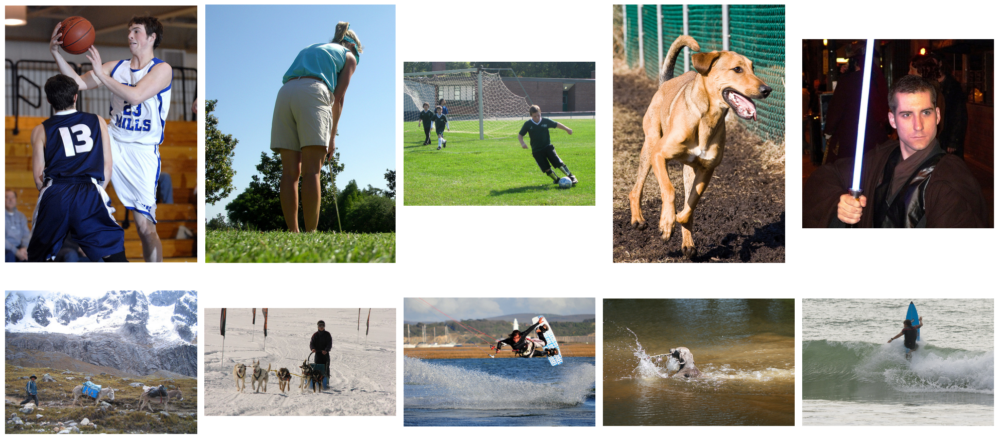

In [ ]:
view_imgs('train_images/', train_set)

Детских фотографий нет, однако на третьей фотографии виден ребенок, посмотрим описание этой фотографии.

In [ ]:
train_set.sample(10, random_state=2)['query_text'].iloc[0]

'The football player wearing a white helmet and orange chairs swing his leg while the player next to him kneels .'

Ни слово о ребенке, либо о его возрасте. В рамках демонстративного решения проигнорируем этот момент, однако на будущее будем знать, что текстовые комментарии не гарантия того, что на фото нет несовершеннолетних.

In [ ]:
train_set.head()

,image,query_id,query_text,metric
0,1056338697_4f7d7ce270.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...,0.0
1,1262583859_653f1469a9.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...,0.0
4,2621415349_ef1a7e73be.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...,0.0
6,3155451946_c0862c70cb.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...,0.0
7,3222041930_f642f49d28.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...,0.0


In [ ]:
train_set.info()

<class 'pandas.core.frame.DataFrame'>
Index: 3957 entries, 0 to 5765
Data columns (total 4 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   image       3957 non-null   object 
 1   query_id    3957 non-null   object 
 2   query_text  3957 non-null   object 
 3   metric      3957 non-null   float64
dtypes: float64(1), object(3)
memory usage: 154.6+ KB


In [ ]:
train_set['image'].unique().shape

(694,)

Осталось 694 изображения из 1000.

#### Вывод по разделу
После удалений описаний связанных с несовершеннолетними детьми мы потеряли около 1500 записей, в итоге у нас осталось 993 изображения из 1000.

## 3. Векторизация изображений

Перейдём к векторизации изображений.

Самый примитивный способ — прочесть изображение и превратить полученную матрицу в вектор. Такой способ нам не подходит: длина векторов может быть сильно разной, так как размеры изображений разные. Поэтому стоит обратиться к свёрточным сетям: они позволяют "выделить" главные компоненты изображений. Как это сделать? Нужно выбрать какую-либо архитектуру, например ResNet-18, посмотреть на слои и исключить полносвязные слои, которые отвечают за конечное предсказание. При этом можно загрузить модель данной архитектуры, предварительно натренированную на датасете ImageNet.

Векторизировать изображения можно по-разному, предлагаю использовать три разных подхода:

- Возьмем модель от Google EfficientNet-b7, которая в 2020 году показывала рекордные метрики на ImageNet

- Возьмем модель VIT от Google на базе архитектуры трансформеров, которая считается в данный момент state of the art

- Возьмем модель Clip от OpenAI, предназначенную для преобразования текста и изображения в эмбеддинг.


#### EfficientNet-b7

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
def get_emb_en(path, model):

    preprocess = transforms.Compose([
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ])
    img = Image.open(path).convert('RGB')
    img_t = preprocess(img)
    model = model.to(device)
    img_t = img_t.unsqueeze(0).to(device)

    model.eval()

    with torch.no_grad():
        embedding = model(img_t)

    return embedding.cpu().numpy().reshape(-1)


In [ ]:
emb_en_model = models.efficientnet_b7(pretrained=True)

emb_en_model.classifier = nn.Identity()

get_emb_en(img_paths[0], emb_en_model).shape

/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=EfficientNet_B7_Weights.IMAGENET1K_V1`. You can also use `weights=EfficientNet_B7_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/efficientnet_b7_lukemelas-c5b4e57e.pth" to /root/.cache/torch/hub/checkpoints/efficientnet_b7_lukemelas-c5b4e57e.pth
100%|██████████| 255M/255M [00:04<00:00, 59.2MB/s] 


(2560,)

In [ ]:
files = os.listdir(os.path.join(DIRECTORY, 'train_images/'))
img2emb = dict.fromkeys(files, 'unknown')

Для каждого изображения в директории train_images мы подберем эмбеддинг.

In [ ]:
for i in tqdm.tqdm(files):
    img2emb[i] = get_emb_en(DIRECTORY + 'train_images/' + i, emb_en_model)

100%|██████████| 1000/1000 [01:05<00:00, 15.38it/s]


In [ ]:
def new_row(row):
    return img2emb[row['image']]

train_set['img2vec_en'] = train_set.apply(new_row, axis=1)

In [ ]:
train_set.head()

,image,query_id,query_text,metric,img2vec_en
0,1056338697_4f7d7ce270.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...,0.0,"[0.69798696, -0.11366517, 0.039951026, -0.1563..."
1,1262583859_653f1469a9.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...,0.0,"[0.17643972, -0.05802197, -0.06338718, -0.0249..."
4,2621415349_ef1a7e73be.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...,0.0,"[0.22545221, -0.15018013, -0.17731671, -0.0676..."
6,3155451946_c0862c70cb.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...,0.0,"[-0.10989229, -0.15433668, -0.15717812, 0.0190..."
7,3222041930_f642f49d28.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...,0.0,"[0.22511157, 0.02274165, -0.07006533, -0.16837..."


#### VIT transformer

In [ ]:
def get_emb_vit(path, model, processor):

    img = Image.open(path).convert('RGB')
    inputs = processor(images=img, return_tensors="pt")
    inputs = {k: v.to(device) for k, v in inputs.items()}
    model.eval()
    with torch.no_grad():
        outputs = model(**inputs)
    logits = outputs.logits
    return logits.cpu().numpy().reshape(-1)

In [ ]:
processor_vit = ViTImageProcessor.from_pretrained('google/vit-base-patch16-224')
emb_vit_model = ViTForImageClassification.from_pretrained('google/vit-base-patch16-224')
emb_vit_model.classifier = nn.Identity()
get_emb_vit(img_paths[0], emb_vit_model.to(device), processor_vit).shape

preprocessor_config.json:   0%|          | 0.00/160 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/69.7k [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/346M [00:00<?, ?B/s]

(768,)

In [ ]:
for i in tqdm.tqdm(files):
    img2emb[i] = get_emb_vit(DIRECTORY + 'train_images/' + i, emb_vit_model.to(device), processor_vit)
train_set['img2vec_vit'] = train_set.apply(new_row, axis=1)

100%|██████████| 1000/1000 [00:22<00:00, 43.63it/s]


In [ ]:
train_set.head()

,image,query_id,query_text,metric,img2vec_en,img2vec_vit
0,1056338697_4f7d7ce270.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...,0.0,"[0.69798696, -0.11366517, 0.039951026, -0.1563...","[0.8643288, 0.5619953, 2.392788, -0.38155043, ..."
1,1262583859_653f1469a9.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...,0.0,"[0.17643972, -0.05802197, -0.06338718, -0.0249...","[0.5276221, 1.448973, 1.4695108, -1.3938694, 0..."
4,2621415349_ef1a7e73be.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...,0.0,"[0.22545221, -0.15018013, -0.17731671, -0.0676...","[-0.081854634, -0.26493752, 0.7978201, 2.86635..."
6,3155451946_c0862c70cb.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...,0.0,"[-0.10989229, -0.15433668, -0.15717812, 0.0190...","[0.30479884, 0.2503907, 0.8057591, -0.10183447..."
7,3222041930_f642f49d28.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...,0.0,"[0.22511157, 0.02274165, -0.07006533, -0.16837...","[0.38353226, -0.06950018, 0.15102094, -1.52763..."


#### CLIP

In [ ]:
processor_clip_emb = CLIPProcessor.from_pretrained("openai/clip-vit-large-patch14")
model_clip_emb = CLIPModel.from_pretrained("openai/clip-vit-large-patch14").to(device)


def get_emb_clip_vis(image_path, model_clip, processor):
    image = Image.open(image_path).convert("RGB")
    image_inputs = processor(images=[image], return_tensors="pt").to(device)
    model_clip = model_clip.to(device)
    with torch.no_grad():
        image_features = model_clip.get_image_features(**image_inputs).unsqueeze(0)
    return image_features.cpu().numpy().reshape(-1)

for i in tqdm.tqdm(files):
    img2emb[i] = get_emb_clip_vis(DIRECTORY + 'train_images/' + i, model_clip_emb.to(device), processor_clip_emb)

train_set['clip_embeddings_vis'] = train_set.apply(new_row, axis=1)

100%|██████████| 1000/1000 [01:18<00:00, 12.66it/s]


In [ ]:
train_set.iloc[0]['clip_embeddings_vis'].shape

(768,)

#### Вывод по разделу
Преобразовали картинки тремя разными способами, получили эмбеддинг размером 2560, 768 через VIT и CLIP.

## 4. Векторизация текстов

Следующий этап — векторизация текстов. Вы можете поэкспериментировать с несколькими способами векторизации текстов:

- tf-idf
- word2vec
- \*трансформеры (например Bert)

\* — если вы изучали трансформеры в спринте Машинное обучение для текстов.


In [ ]:
train_set.info()

<class 'pandas.core.frame.DataFrame'>
Index: 3957 entries, 0 to 5765
Data columns (total 7 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   image                3957 non-null   object 
 1   query_id             3957 non-null   object 
 2   query_text           3957 non-null   object 
 3   metric               3957 non-null   float64
 4   img2vec_en           3957 non-null   object 
 5   img2vec_vit          3957 non-null   object 
 6   clip_embeddings_vis  3957 non-null   object 
dtypes: float64(1), object(6)
memory usage: 247.3+ KB


### DistilBert

Будем использовать DistilBert для создания эмбеддингов, так как этот трансформер очень быстрый.

In [ ]:
tokenizer = DistilBertTokenizer.from_pretrained("distilbert/distilbert-base-uncased")
model = DistilBertModel.from_pretrained("distilbert/distilbert-base-uncased")
model.to(device)
model.eval()

def vectorize(text):
    inputs = tokenizer(text, return_tensors='pt', padding=True, truncation=True, max_length=512).to(device)
    with torch.no_grad():
        outputs = model(**inputs)
        hidden_states = outputs.last_hidden_state
        attention_mask = inputs["attention_mask"].unsqueeze(-1).expand(hidden_states.size())
        masked_hidden_states = hidden_states * attention_mask
        pooled_output = torch.sum(masked_hidden_states, dim=1) / torch.clamp(attention_mask.sum(dim=1), min=1e-9)
    return pooled_output.cpu().numpy().reshape(-1)



tokenizer_config.json:   0%|          | 0.00/28.0 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

config.json:   0%|          | 0.00/483 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/268M [00:00<?, ?B/s]

In [ ]:
tqdm.tqdm.pandas()

train_set['text2vec'] = train_set['query_text'].progress_apply(vectorize)

100%|██████████| 3957/3957 [00:23<00:00, 166.89it/s]


In [ ]:
train_set['text2vec'].iloc[0].shape

(768,)

In [ ]:
train_set['img2vec_en'].iloc[0].shape

(2560,)

### CLIP

In [ ]:
def get_text_embeddings(texts):
    text_inputs = processor_clip_emb(text=[texts], return_tensors="pt", padding=True).to(device)
    with torch.no_grad():
        text_features = model_clip_emb.get_text_features(**text_inputs).unsqueeze(1)

    return text_features.cpu().numpy().reshape(-1)

train_set['clip_embeddings_text'] = train_set['query_text'].progress_apply(get_text_embeddings)

100%|██████████| 3957/3957 [00:39<00:00, 99.45it/s] 


In [ ]:
train_set['clip_embeddings_text'].iloc[0].shape

(768,)

#### Вывод по разделу
С помощью DistilBert создали эмбеддинги размером в 512 для каждого описания, а также использовали Clip для создания текстовых эмбеддингов.

## 5. Объединение векторов

Подготовьте данные для обучения: объедините векторы изображений и векторы текстов с целевой переменной.

Прежде чем объединять, рассмотрим распределения:

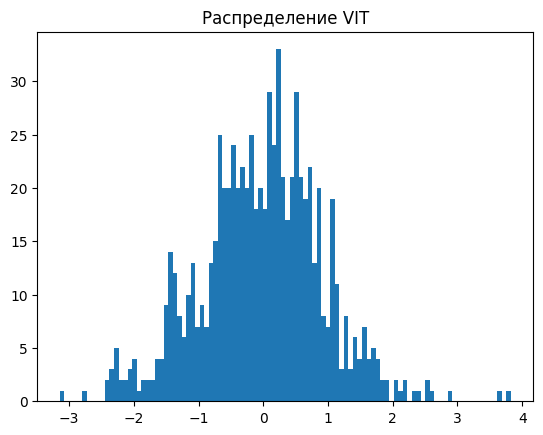

In [ ]:
plt.hist(train_set['img2vec_vit'].iloc[0], bins=100);
plt.title('Распределение VIT')
plt.show()

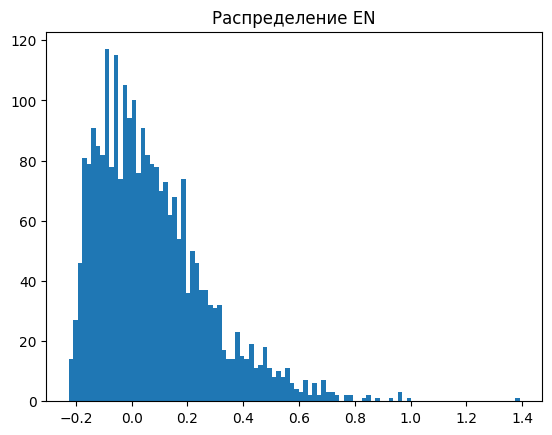

In [ ]:
plt.hist(train_set['img2vec_en'].iloc[0], bins=100)
plt.title('Распределение EN')
plt.show()

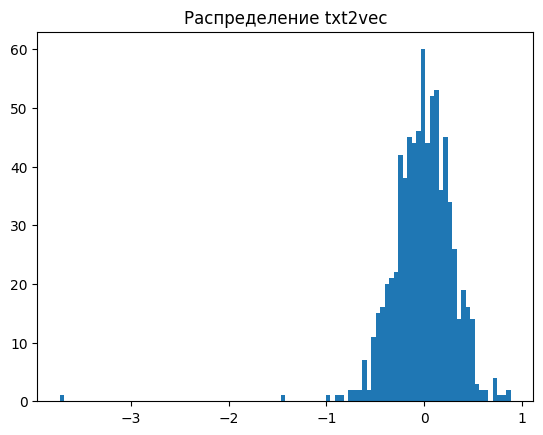

In [ ]:
plt.hist(train_set['text2vec'].iloc[0], bins=100);
plt.title('Распределение txt2vec')
plt.show()

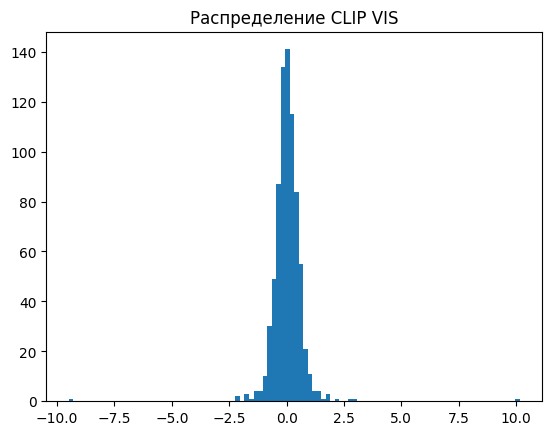

In [ ]:
plt.hist(train_set['clip_embeddings_vis'].iloc[0], bins=100);
plt.title('Распределение CLIP VIS')
plt.show()

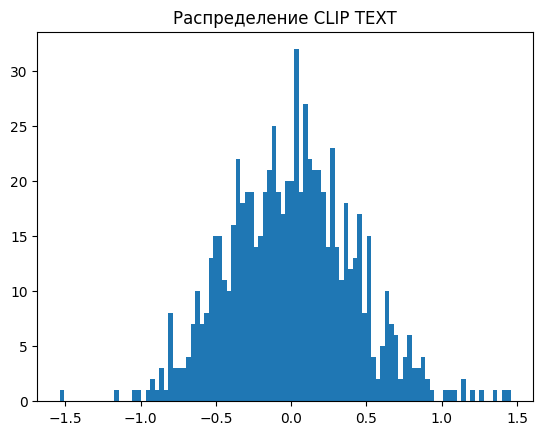

In [ ]:
plt.hist(train_set['clip_embeddings_text'].iloc[0], bins=100);
plt.title('Распределение CLIP TEXT')
plt.show()

Распределение текстовых эмбеддингов отличается изображения, нужно нормализовать вектора перед обучением.

Объединим эмбеддинги: текст и изображение соединим в один вектор.

In [ ]:
def conc(row, col1, col2):
    return np.concatenate((row[col1], row[col2]))
train_set['final_vec_en'] = train_set.apply(lambda row: conc(row, 'text2vec', 'img2vec_en'), axis=1)
train_set['final_vec_vic'] = train_set.apply(lambda row: conc(row, 'text2vec', 'img2vec_vit'), axis=1)
train_set['clip_embeddings'] = train_set.apply(lambda row: conc(row, 'clip_embeddings_vis', 'clip_embeddings_text'), axis=1)


In [ ]:
train_set2 = train_set.copy()
train_set3 = train_set.copy()


In [ ]:
train_set2.drop(columns=['img2vec_en', 'final_vec_en', 'clip_embeddings'], inplace=True)

In [ ]:
train_set.drop(columns=['img2vec_vit', 'final_vec_vic', 'clip_embeddings'], inplace=True)

In [ ]:
train_set3.drop(columns=['img2vec_vit', 'final_vec_vic', 'img2vec_en', 'final_vec_en'], inplace=True)

In [ ]:
train_set = train_set.dropna().reset_index(drop=True)
train_set2 = train_set2.dropna().reset_index(drop=True)
train_set3 = train_set3.dropna().reset_index(drop=True)


In [ ]:
train_set3['clip_embeddings'].iloc[0].shape

(1536,)

#### Вывод по разделу
В итоге получили 3 эмбеддинга: VIT + DistilBert, EfficientNet + DistilBert, Clip. Размер EN 3328, размер VIT 1536, размер clip 1280.

## 6. Обучение модели предсказания соответствия

Для обучения разделите датасет на тренировочную и тестовую выборки. Простое случайное разбиение не подходит: нужно исключить попадание изображения и в обучающую, и в тестовую выборки.
Для того чтобы учесть изображения при разбиении, можно воспользоваться классом [GroupShuffleSplit](https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.GroupShuffleSplit.html) из библиотеки sklearn.model_selection.

Код ниже разбивает датасет на тренировочную и тестовую выборки в пропорции 7:3 так, что строки с одинаковым значением 'group_column' будут содержаться либо в тестовом, либо в тренировочном датасете.

```
from sklearn.model_selection import GroupShuffleSplit
gss = GroupShuffleSplit(n_splits=1, train_size=.7, random_state=42)
train_indices, test_indices = next(gss.split(X=df.drop(columns=['target']), y=df['target'], groups=df['group_column']))
train_df, test_df = df.loc[train_indices], df.loc[test_indices]

```

Какую модель использовать — выберите самостоятельно. Также вам предстоит выбрать метрику качества либо реализовать свою.

### Предобработка на датасеты

In [ ]:
gss_1 = GroupShuffleSplit(n_splits=1, train_size=.7, random_state=42)
train_indices, valid_indices = next(gss_1.split(X=train_set.drop(columns=['metric']), y=train_set['metric'], groups=train_set['image']))
train_df, valid_df = train_set.loc[train_indices], train_set.loc[valid_indices]

In [ ]:
gss_2 = GroupShuffleSplit(n_splits=1, train_size=.7, random_state=42)
train_indices_2, valid_indices_2 = next(gss_2.split(X=train_set2.drop(columns=['metric']), y=train_set2['metric'], groups=train_set2['image']))
train_df2, valid_df2 = train_set2.loc[train_indices_2], train_set2.loc[valid_indices_2]

In [ ]:
gss_3 = GroupShuffleSplit(n_splits=1, train_size=.7, random_state=42)
train_indices_3, valid_indices_3 = next(gss_3.split(X=train_set3.drop(columns=['metric']), y=train_set3['metric'], groups=train_set3['image']))
train_df3, valid_df3 = train_set3.loc[train_indices_2], train_set3.loc[valid_indices_2]

In [ ]:
features_vit_train = train_df2.loc[:, 'final_vec_vic'].values
features_vit_valid = valid_df2.loc[:, 'final_vec_vic'].values

features_en_train = train_df.loc[:, 'final_vec_en'].values
features_en_valid = valid_df.loc[:, 'final_vec_en'].values


features_clip_train = train_df3.loc[:, 'clip_embeddings'].values
features_clip_valid = valid_df3.loc[:, 'clip_embeddings'].values

In [ ]:
features_vit_train = np.array([np.array(x) for x in features_vit_train])
features_vit_valid = np.array([np.array(x) for x in features_vit_valid])

features_en_train = np.array([np.array(x) for x in features_en_train])
features_en_valid = np.array([np.array(x) for x in features_en_valid])


features_clip_train = np.array([np.array(x) for x in features_clip_train])
features_clip_valid = np.array([np.array(x) for x in features_clip_valid])

In [ ]:
features_vit_train.shape

(2746, 1536)

Напомню, что так как распределения отличаются, то имеет смысл в нормализации.

In [ ]:
scaler_vic = StandardScaler()
scaler_en = StandardScaler()
scaler_clip = StandardScaler()

features_vit_train = scaler_vic.fit_transform(features_vit_train)
features_vit_valid = scaler_vic.transform(features_vit_valid)

features_en_train = scaler_en.fit_transform(features_en_train)
features_en_valid = scaler_en.transform(features_en_valid)

features_clip_train = scaler_clip.fit_transform(features_clip_train)
features_clip_valid = scaler_clip.transform(features_clip_valid)

In [ ]:
y_train_en, y_valid_en = train_set.loc[train_indices, 'metric'], train_set.loc[valid_indices, 'metric']

In [ ]:
y_train_vit, y_valid_vit = train_set2.loc[train_indices_2, 'metric'], train_set2.loc[valid_indices_2, 'metric']

In [ ]:
y_train_clip, y_valid_clip = train_set3.loc[train_indices_3, 'metric'], train_set3.loc[valid_indices_3, 'metric']

 ### Обучение моделей

### Линейная регрессия

In [ ]:
score_lists = []

#### EfficientNet + DistilBert

In [ ]:
lr_en = LinearRegression()
lr_en.fit(features_en_train, y_train_en)
print('RMSE', mean_squared_error(y_valid_en, lr_en.predict(features_en_valid)) ** 0.5)
score_lists.append(mean_squared_error(y_valid_en, lr_en.predict(features_en_valid)) ** 0.5)


RMSE 103.6930188926194


#### VIT + DistilBert

In [ ]:
lr_vit = LinearRegression()
lr_vit.fit(features_vit_train, y_train_vit)
print('RMSE', mean_squared_error(y_valid_vit, lr_vit.predict(features_vit_valid)) ** 0.5)
score_lists.append(mean_squared_error(y_valid_vit, lr_vit.predict(features_vit_valid)) ** 0.5)



RMSE 309.5374945408771


#### Clip

In [ ]:
lr_clip = LinearRegression()
lr_clip.fit(features_clip_train, y_train_clip)
print('RMSE', mean_squared_error(y_valid_clip, lr_clip.predict(features_clip_valid)) ** 0.5)
score_lists.append(mean_squared_error(y_valid_clip, lr_clip.predict(features_clip_valid)) ** 0.5)



RMSE 48.51519407674527


### NN

In [ ]:
class ThisDataset(Dataset):
    def __init__(self, features, labels):

        if labels.dtype.kind in 'iu':
            labels_dtype = torch.long
        else:
            labels_dtype = torch.float32

        self.features = torch.tensor(features, dtype=torch.float32)
        self.labels = torch.tensor(labels.values, dtype=torch.float32)

    def __len__(self):
        return len(self.features)

    def __getitem__(self, idx):
        return self.features[idx], self.labels[idx]


In [ ]:
train_vit_dataset = ThisDataset(features_vit_train, y_train_vit)
valid_vit_dataset = ThisDataset(features_vit_valid, y_valid_vit)

train_en_dataset = ThisDataset(features_en_train, y_train_en)
valid_en_dataset = ThisDataset(features_en_valid, y_valid_en)

train_clip_dataset = ThisDataset(features_clip_train, y_train_clip)
valid_clip_dataset = ThisDataset(features_clip_valid, y_valid_clip)

In [ ]:
train_vit_dl = DataLoader(train_vit_dataset, batch_size=64, shuffle=True)
valid_vit_dl = DataLoader(valid_vit_dataset, batch_size=64, shuffle=False)

train_en_dl = DataLoader(train_en_dataset, batch_size=64, shuffle=True)
valid_en_dl = DataLoader(valid_en_dataset, batch_size=64, shuffle=False)

train_clip_dl = DataLoader(train_clip_dataset, batch_size=64, shuffle=True)
valid_clip_dl = DataLoader(valid_clip_dataset, batch_size=64, shuffle=False)

In [ ]:
class Model(nn.Module):
    def __init__(self, input_size):
        super(Model, self).__init__()
        self.fc1 = nn.Linear(input_size, 5200)
        self.bn1 = nn.BatchNorm1d(5200)
        self.fa1 = nn.LeakyReLU()
        self.fc2 = nn.Linear(5200, 4800)
        self.bn2 = nn.BatchNorm1d(4800)
        self.fa2 = nn.LeakyReLU()
        self.fc3 = nn.Linear(4800, 3700)
        self.bn3 = nn.BatchNorm1d(3700)
        self.fa3 = nn.LeakyReLU()
        self.fc4 = nn.Linear(3700, 2900)
        self.bn4 = nn.BatchNorm1d(2900)
        self.fa4 = nn.LeakyReLU()
        self.fc5 = nn.Linear(2900, 1200)
        self.bn5 = nn.BatchNorm1d(1200)
        self.fa5 = nn.LeakyReLU()
        self.fc6 = nn.Linear(1200, 1)
        self.fa6 = nn.ReLU()


    def forward(self, x):
        x = self.bn1(self.fa1(self.fc1(x)))
        x = self.bn2(self.fa2(self.fc2(x)))
        x = self.bn3(self.fa3(self.fc3(x)))
        x = self.bn4(self.fa4(self.fc4(x)))
        x = self.bn5(self.fa5(self.fc5(x)))
        x = (self.fc6(x))
        return x

In [ ]:
def fit(epochs, model, loss_func, opt, train_dl, valid_dl, lr_sched=None):
    train_losses = []
    val_losses = []
    valid_rmse = []
    for epoch in range(epochs):
        model.train()
        loss_sum = 0
        for xb, yb in tqdm.tqdm(train_dl):
            xb, yb = xb.to(device), yb.to(device)
            output = model(xb)
            output = output.squeeze(-1)
            loss = loss_func(output, yb)
            loss_sum += loss.item()

            loss.backward()
            opt.step()
            opt.zero_grad()
        train_losses.append(loss_sum / len(train_dl))

        model.eval()
        loss_sum = 0
        mse = 0
        num_samples = 0
        for xb, yb in valid_dl:
            xb, yb = xb.to(device), yb.to(device)
            probs = model(xb)
            probs = probs.squeeze(-1)
            loss_sum += loss_func(probs, yb).item()

            preds = probs.cpu().detach().numpy()
            yb_cpu = yb.cpu().detach().numpy()
            mse += mean_squared_error(yb_cpu, preds) * len(yb)
            num_samples += len(yb)

        val_losses.append(loss_sum / len(valid_dl))
        valid_rmse.append((mse / num_samples) ** 0.5)

        if lr_sched:
            lr_sched.step()

    return train_losses, val_losses, valid_rmse

In [ ]:
def predict(model, data_list):
    model.eval()
    predictions = []

    with torch.no_grad():
        for data in (data_list):
            data = torch.tensor(data)
            data = data.to(device).float()
            output = model(data.unsqueeze(0))
            predictions.append(output.cpu().numpy())

    return np.concatenate(predictions)

In [ ]:
def plot_trainig(train_losses, valid_losses, valid_accuracies):
    plt.figure(figsize=(12, 9))
    plt.subplot(2, 1, 1)
    plt.xlabel('epoch')
    plt.ylim(0, 0.15)
    plt.plot(train_losses, label='train_loss')
    plt.plot(valid_losses, label='valid_loss')
    plt.legend()

    plt.subplot(2, 1, 2)
    plt.xlabel('epoch')
    plt.plot(valid_accuracies, label='valid rmse')
    plt.legend()

#### EfficientNet + DistilBert

100%|██████████| 43/43 [00:01<00:00, 31.02it/s]


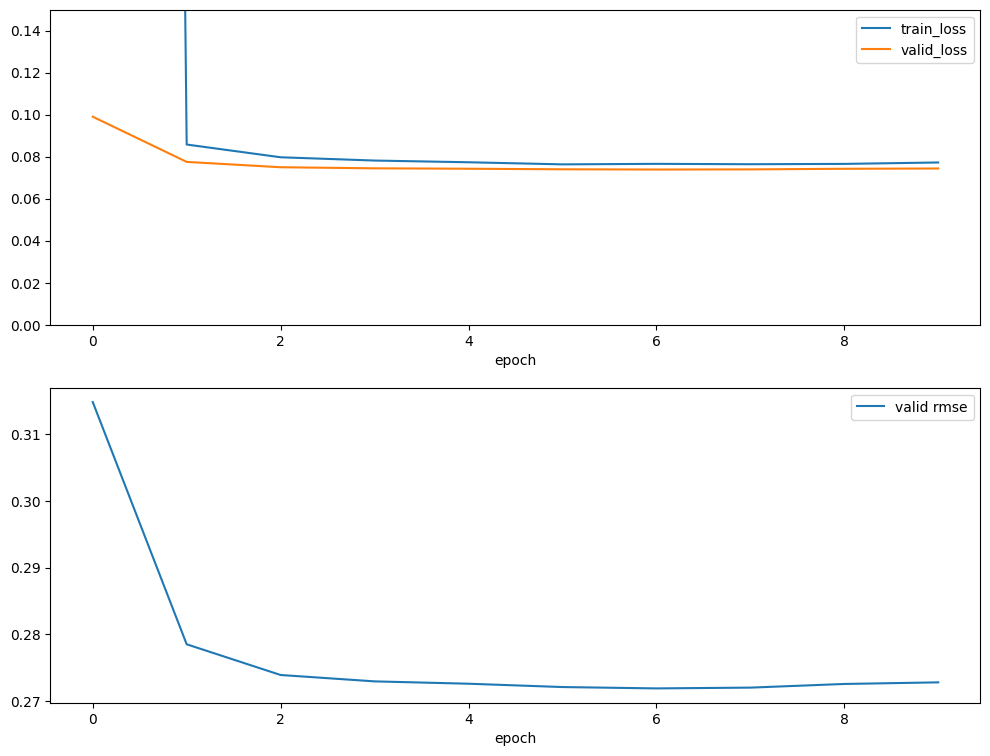

In [ ]:
model_en = Model(3328).to(device)
criterion = nn.MSELoss()
optimizer = torch.optim.AdamW(model_en.parameters(), lr=0.001, betas=(0.9, 0.999), weight_decay=1e-2)
scheduler = torch.optim.lr_scheduler.ExponentialLR(optimizer=optimizer, gamma=0.5)
info = fit(10, model_en, criterion, optimizer, train_en_dl, valid_en_dl, scheduler)
plot_trainig(*info)

In [ ]:
print('RMSE', mean_squared_error(y_valid_en, predict(model_en, features_en_valid)) ** 0.5)
score_lists.append(mean_squared_error(y_valid_en, predict(model_en, features_en_valid)) ** 0.5)

RMSE 0.2728030765007719


#### VIT + DistilBert

100%|██████████| 43/43 [00:01<00:00, 34.96it/s]


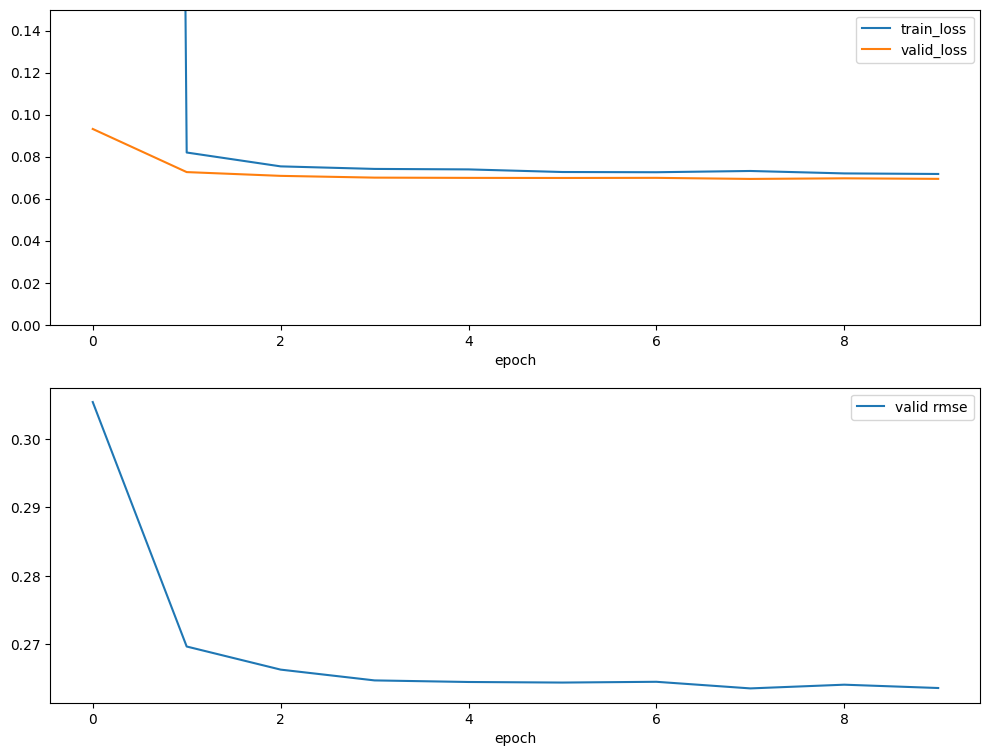

In [ ]:
model_vit = Model(1536).to(device)
criterion = nn.MSELoss()
optimizer = torch.optim.AdamW(model_vit.parameters(), lr=0.001, betas=(0.9, 0.999), weight_decay=1e-2)
scheduler = torch.optim.lr_scheduler.ExponentialLR(optimizer=optimizer, gamma=0.5)
info = fit(10, model_vit, criterion, optimizer, train_vit_dl, valid_vit_dl, scheduler)
plot_trainig(*info)

In [ ]:
print('RMSE', mean_squared_error(y_valid_vit, predict(model_vit, features_vit_valid)) ** 0.5)
score_lists.append(mean_squared_error(y_valid_vit, predict(model_vit, features_vit_valid)) ** 0.5)

RMSE 0.26360660503839134


#### Clip

100%|██████████| 43/43 [00:01<00:00, 34.95it/s]


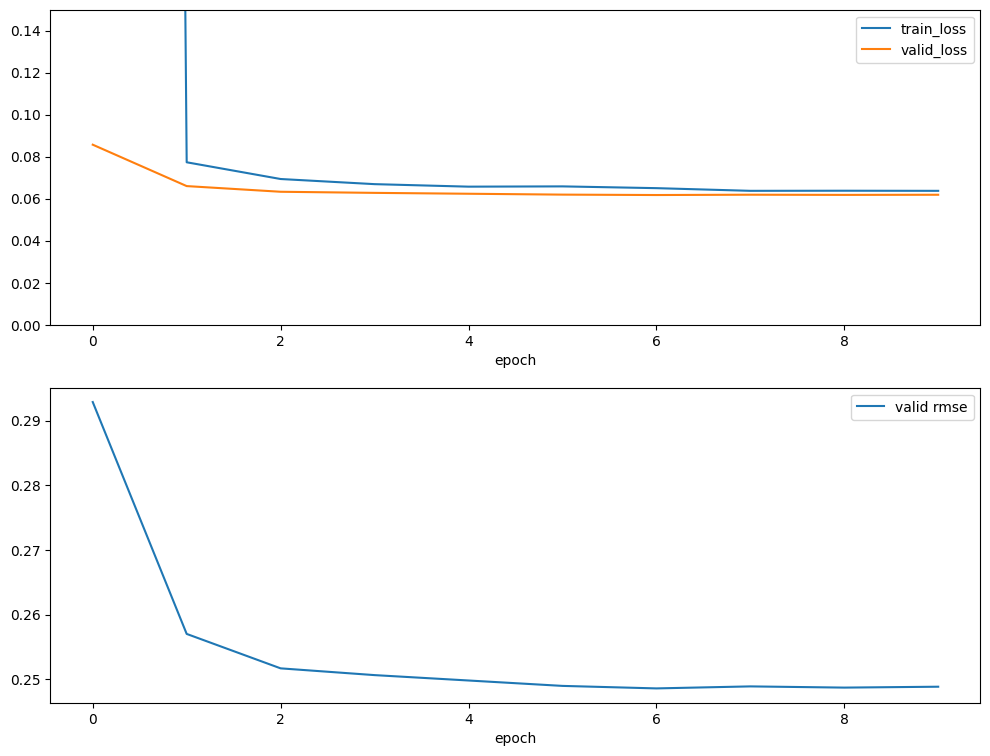

In [ ]:
model_clip = Model(1536).to(device)
criterion = nn.MSELoss()
optimizer = torch.optim.AdamW(model_clip.parameters(), lr=0.001, betas=(0.9, 0.999), weight_decay=1e-2)
scheduler = torch.optim.lr_scheduler.ExponentialLR(optimizer=optimizer, gamma=0.5)
info = fit(10, model_clip, criterion, optimizer, train_clip_dl, valid_clip_dl, scheduler)
plot_trainig(*info)

In [ ]:
print('RMSE', mean_squared_error(y_valid_clip, predict(model_clip, features_clip_valid)) ** 0.5)
score_lists.append(mean_squared_error(y_valid_clip, predict(model_clip, features_clip_valid)) ** 0.5)

RMSE 0.2488388008359211


Результат на нейронный сетях значительно превосходит результат через линейную регрессию, Clip показала лучшее качество

### CatBoost

#### EfficientNet + DistilBert

In [ ]:
cbc_en = catboost.CatBoostRegressor(verbose=False, task_type='GPU', random_state=12, border_count=100)
cbc_en.fit(features_en_train, y_train_en)
print('RMSE', mean_squared_error(y_valid_en, cbc_en.predict(features_en_valid)) ** 0.5)
score_lists.append(mean_squared_error(y_valid_en, cbc_en.predict(features_en_valid)) ** 0.5)

RMSE 0.25062733358273437


#### VIT + DistilBert

In [ ]:
cbc_vit = catboost.CatBoostRegressor(verbose=False, task_type='GPU', random_state=12, border_count=100)
cbc_vit.fit(features_vit_train, y_train_vit)
print('RMSE', mean_squared_error(y_valid_vit, cbc_vit.predict(features_vit_valid)) ** 0.5)
score_lists.append(mean_squared_error(y_valid_vit, cbc_vit.predict(features_vit_valid)) ** 0.5)

RMSE 0.24513713797932019


#### Clip

In [ ]:
cbc_clip = catboost.CatBoostRegressor(verbose=False, task_type='GPU', random_state=12, border_count=100)
cbc_clip.fit(features_clip_train, y_train_clip)
print('RMSE', mean_squared_error(y_valid_clip, cbc_clip.predict(features_clip_valid)) ** 0.5)
score_lists.append(mean_squared_error(y_valid_clip, cbc_clip.predict(features_clip_valid)) ** 0.5)

RMSE 0.23041720041758057


### Выбираем лучшую модель

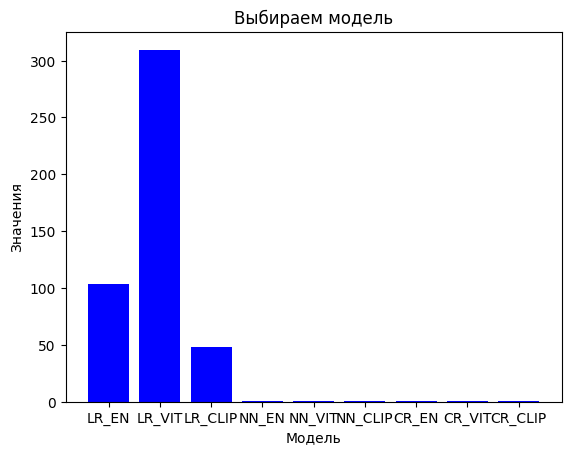

In [ ]:
categories = ['LR_EN', 'LR_VIT', 'LR_CLIP', 'NN_EN', 'NN_VIT', 'NN_CLIP', 'CR_EN', 'CR_VIT', 'CR_CLIP']
values = np.array(score_lists)

fig, ax = plt.subplots()

ax.bar(categories, values, color='blue')

ax.set_xlabel('Модель')
ax.set_ylabel('Значения')
ax.set_title('Выбираем модель')

plt.show()

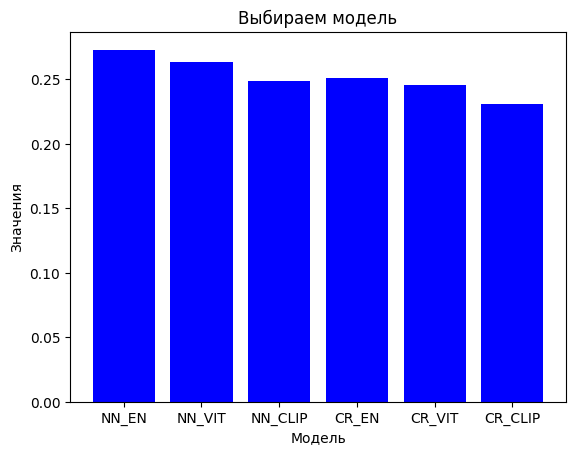

In [ ]:
categories = ['NN_EN', 'NN_VIT', 'NN_CLIP', 'CR_EN', 'CR_VIT', 'CR_CLIP']
values = np.array(score_lists)

fig, ax = plt.subplots()

ax.bar(categories, values[3:], color='blue')

ax.set_xlabel('Модель')
ax.set_ylabel('Значения')
ax.set_title('Выбираем модель')

plt.show()

Лучший результат показала модель CatBoost на эмбеддингах Clip, ее и возьмем в конечном итоге.

#### Вывод по разделу
В рамках раздела на наших эмбеддингах мы протестировали три модели: линейная регрессия, полносвязную сеть (leaky_relu + batchnorm) и градиентный бустинг. Из тех моделей худший результат мы ожидаемо получили на самой простой модели, а именно на линейной регрессии. Лучший результат был получен на градиентном бустинге с эмбеддингами Clip,их мы и будем использовать.

## 7. Тестирование модели

Настало время протестировать модель. Для этого получите эмбеддинги для всех тестовых изображений из папки `test_images`, выберите случайные 10 запросов из файла `test_queries.csv` и для каждого запроса выведите наиболее релевантное изображение. Сравните визуально качество поиска.

In [ ]:
test_set.head()

,image
0,3356748019_2251399314.jpg
1,2887171449_f54a2b9f39.jpg
2,3089107423_81a24eaf18.jpg
3,1429546659_44cb09cbe2.jpg
4,1177994172_10d143cb8d.jpg


In [ ]:
test_queries.head()

,query_id,query_text,image
0,1177994172_10d143cb8d.jpg#0,"Two blonde boys , one in a camouflage shirt an...",1177994172_10d143cb8d.jpg
1,1177994172_10d143cb8d.jpg#1,Two boys are squirting water guns at each other .,1177994172_10d143cb8d.jpg
2,1177994172_10d143cb8d.jpg#2,Two boys spraying each other with water,1177994172_10d143cb8d.jpg
3,1177994172_10d143cb8d.jpg#3,Two children wearing jeans squirt water at eac...,1177994172_10d143cb8d.jpg
4,1177994172_10d143cb8d.jpg#4,Two young boys are squirting water at each oth...,1177994172_10d143cb8d.jpg


In [ ]:
test_set.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100 entries, 0 to 99
Data columns (total 1 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   image   100 non-null    object
dtypes: object(1)
memory usage: 928.0+ bytes


In [ ]:
test_queries.info()

<class 'pandas.core.frame.DataFrame'>
Index: 500 entries, 0 to 499
Data columns (total 3 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   query_id    500 non-null    object
 1   query_text  500 non-null    object
 2   image       500 non-null    object
dtypes: object(3)
memory usage: 15.6+ KB


### Эмбеддинги

In [ ]:
test_files = os.listdir(os.path.join(DIRECTORY, 'test_images/'))
img2emb_test = dict.fromkeys(test_files, 'unknown')

In [ ]:

for i in tqdm.tqdm(test_files):
    img2emb_test[i] = get_emb_clip_vis(DIRECTORY + 'test_images/' + i, model_clip_emb.to(device), processor_clip_emb)


100%|██████████| 100/100 [00:07<00:00, 12.67it/s]


### Наша собственная модель

In [ ]:
def search_image_by_text(text, img_embs):
    for word in minor_keywords:
        if word in text.lower():
            return None
    text_embedding = get_text_embeddings(text)

    best_score = -np.inf
    best_key = None

    for key, value in img_embs.items():
        sample_emb = scaler_clip.transform(np.concatenate((text_embedding, img_embs[key])).reshape(1, -1))
        if ((cbc_clip.predict(sample_emb))[0] ** 0.5) > best_score:
            best_score = (cbc_clip.predict(sample_emb))[0] **0.5
            best_key = key
    return best_score, best_key






In [ ]:
if search_image_by_text('child', img2emb_test) is None:
    print('This image is unavailable in your country in compliance with local laws.')
else:
    print('No problem')


This image is unavailable in your country in compliance with local laws.


Фильтр работает.

In [ ]:
url = IMAGE_URL

save_path = os.path.join(SAVE_DIRECTORY, 'not-available.jpg')


response = requests.get(url)
if response.status_code == 200:
    image = Image.open(BytesIO(response.content))

    image.save(save_path)

In [ ]:
def sample_check(test_sample):
    labels = []
    paths = []
    for i in test_sample:
        if search_image_by_text(i, img2emb_test) is None:
            labels.append(i +' \nThis image is unavailable in your country in compliance with local laws.')
            paths.append(save_path)
        else:
            score, key = search_image_by_text(i, img2emb_test)
            labels.append(i + ' ' + str(score))
            paths.append(DIRECTORY + 'test_images/' + key)
    return labels, paths


In [ ]:
labels, img_paths = sample_check(test_queries.sample(10, random_state=2)['query_text'])

/tmp/ipykernel_34/3826445209.py:12: RuntimeWarning: invalid value encountered in scalar power
  if ((cbc_clip.predict(sample_emb))[0] ** 0.5) > best_score:
/tmp/ipykernel_34/3826445209.py:12: RuntimeWarning: invalid value encountered in scalar power
  if ((cbc_clip.predict(sample_emb))[0] ** 0.5) > best_score:
/tmp/ipykernel_34/3826445209.py:12: RuntimeWarning: invalid value encountered in scalar power
  if ((cbc_clip.predict(sample_emb))[0] ** 0.5) > best_score:
/tmp/ipykernel_34/3826445209.py:12: RuntimeWarning: invalid value encountered in scalar power
  if ((cbc_clip.predict(sample_emb))[0] ** 0.5) > best_score:


In [ ]:
def view_result(labels, img_paths):
    custom_dataset = OwnDataset(img_paths, labels, transform=transform)

    def my_collate(batch):
        images = [item[0] for item in batch]
        labels = [item[1] for item in batch]
        return images, labels

    data_loader = DataLoader(custom_dataset, batch_size=10, shuffle=True, collate_fn=my_collate)

    images, labels = next(iter(data_loader))

    for image, label in zip(images, labels):
        plt.imshow(image.permute(1, 2, 0))
        plt.title(label)
        plt.axis('off')
        plt.show()


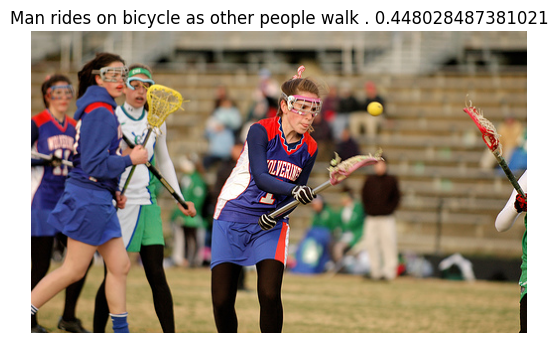

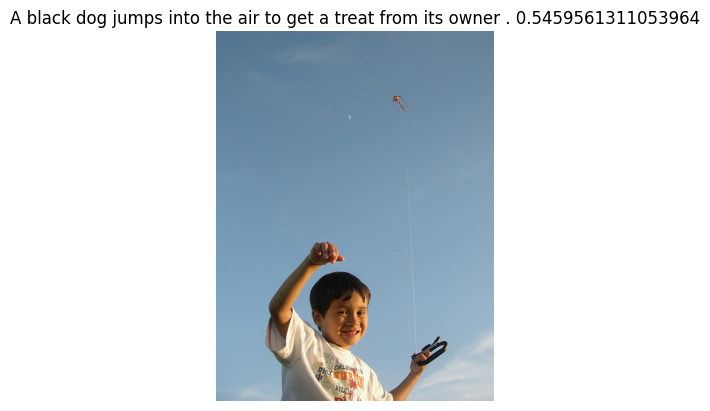

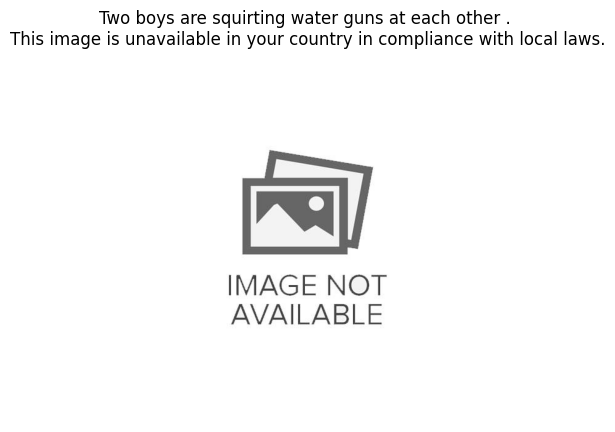

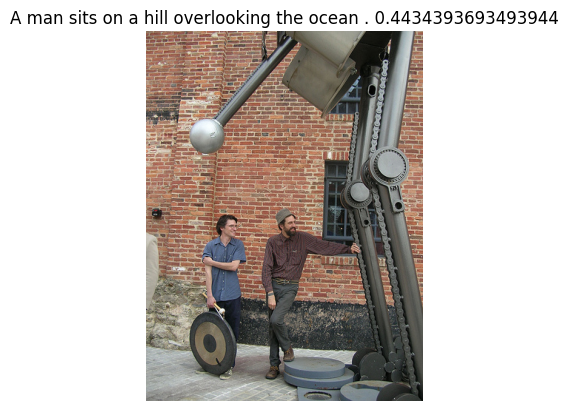

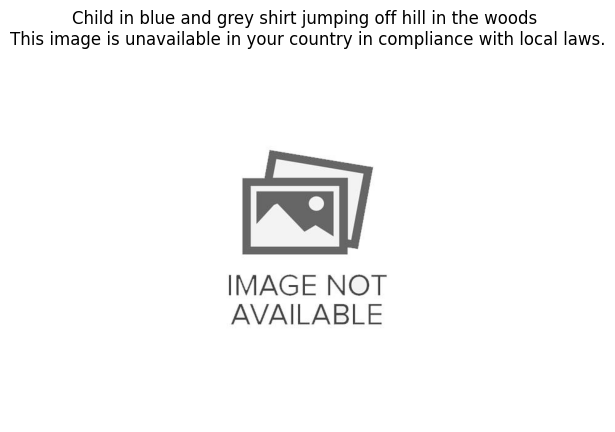

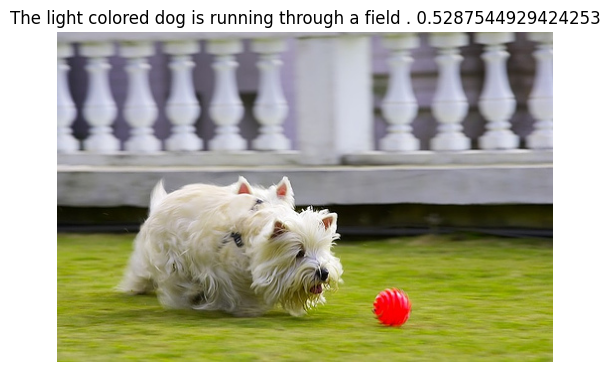

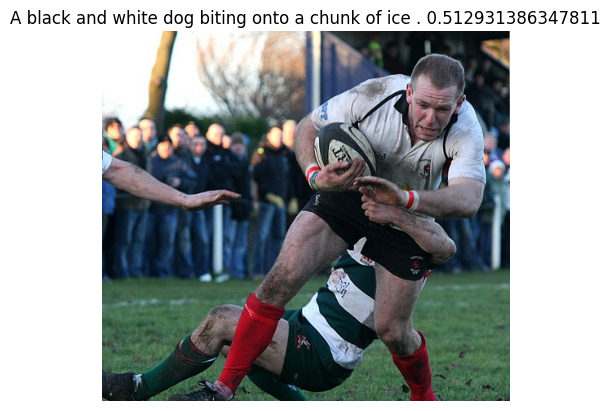

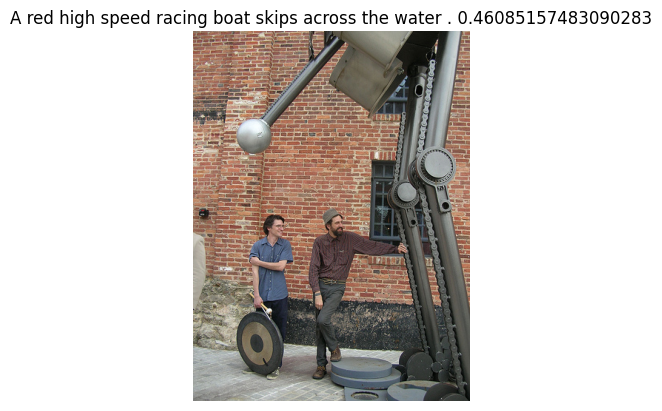

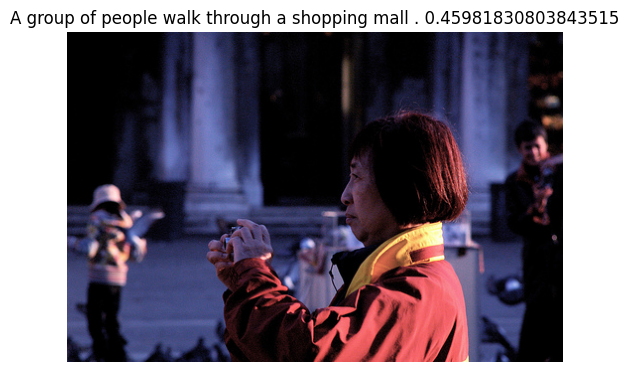

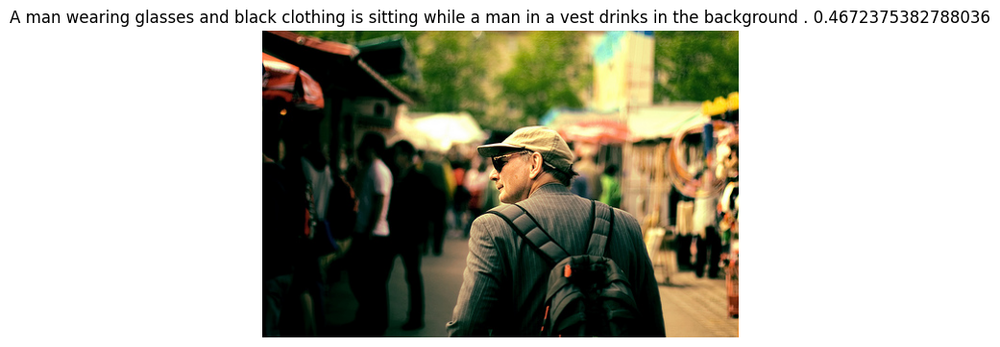

In [ ]:
view_result(labels, img_paths)

Получили довольно посредственный результат, который возможно получился таким из-за маленькой выборки. Посмотрим, что бы было, если бы мы использовали косинусное расстояние:

### Косинусное расстояние

In [ ]:
test_files = os.listdir(os.path.join(DIRECTORY, 'test_images/'))
img2emb_vit = {os.path.join(DIRECTORY, 'test_images', file): 'unknown' for file in test_files}



In [ ]:


def find_best_image_for_text(text, image_paths):

    for word in minor_keywords:
        if word in text.lower():
            return None
    text_features = get_text_embeddings(text)
    best_score = -1
    best_image_path = None

    for image_path in image_paths:
        image_features = img2emb_test[image_path]
        cos_sim = cosine_similarity(text_features.reshape(1, -1), image_features.reshape(1, -1)).item()

        if cos_sim > best_score:
            best_score = cos_sim
            best_image_path = image_path

    return best_score, best_image_path

In [ ]:
def sample_check(test_sample):
    labels = []
    paths = []
    for i in tqdm.tqdm(test_sample):
        if find_best_image_for_text(i, img2emb_test) is None:
            labels.append(i +' \nThis image is unavailable in your country in compliance with local laws.')
            paths.append(save_path)
        else:
            score, key = find_best_image_for_text(i, img2emb_test)
            labels.append(i + ' ' + str(score))
            paths.append(DIRECTORY + 'test_images/' + key)
    return labels, paths


In [ ]:
labels, img_paths = sample_check(test_queries.sample(10, random_state=2)['query_text'])

100%|██████████| 10/10 [00:00<00:00, 15.98it/s]


In [ ]:
labels[0]

'The light colored dog is running through a field . 0.3049778938293457'

In [ ]:
img_paths

['/kaggle/input/text-to-img/to_upload/test_images/2505465055_f1e6cf9b76.jpg',
 '/kaggle/input/text-to-img/to_upload/test_images/3262849619_0bc4f88ef9.jpg',
 '/kaggle/input/text-to-img/to_upload/test_images/782401952_5bc5d3413a.jpg',
 '/kaggle/input/text-to-img/to_upload/test_images/3517023411_a8fbd15230.jpg',
 '/kaggle/input/text-to-img/to_upload/test_images/3091962081_194f2f3bd4.jpg',
 '/kaggle/input/text-to-img/to_upload/test_images/3722572342_6904d11d52.jpg',
 '/kaggle/working/not-available.jpg',
 '/kaggle/input/text-to-img/to_upload/test_images/424307754_1e2f44d265.jpg',
 '/kaggle/input/text-to-img/to_upload/test_images/345785626_9fa59f38ce.jpg',
 '/kaggle/working/not-available.jpg']

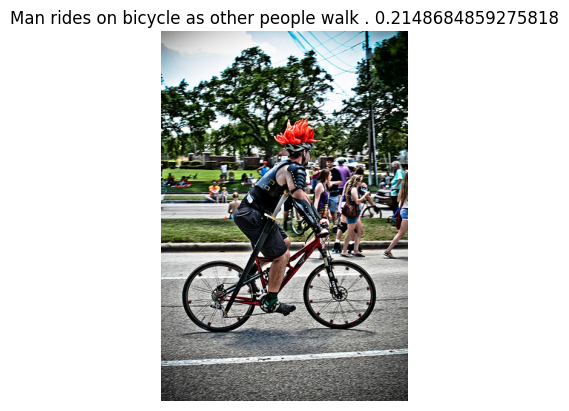

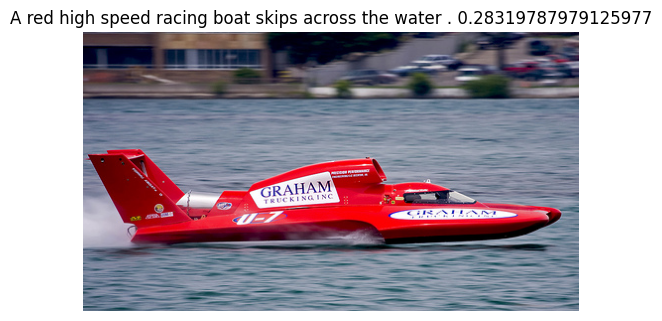

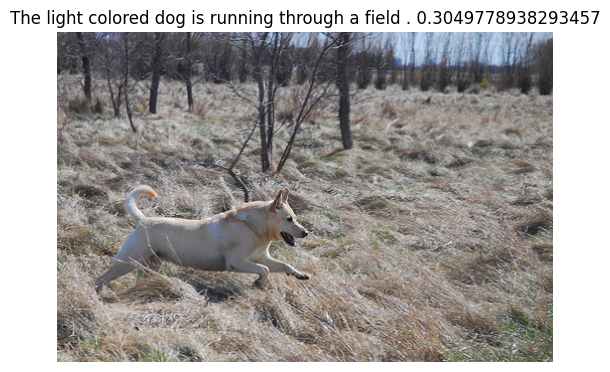

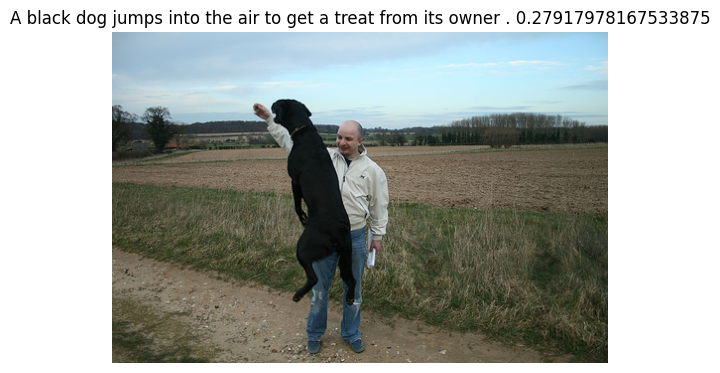

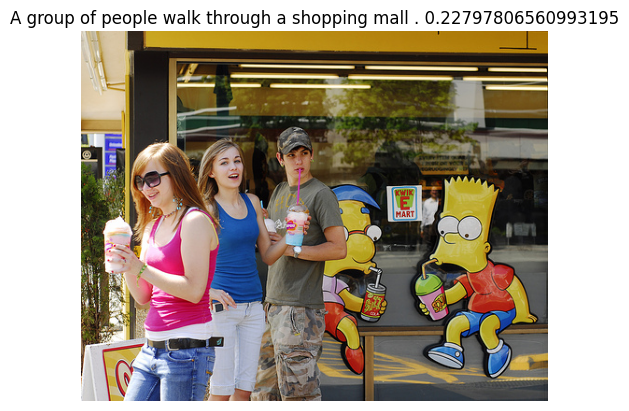

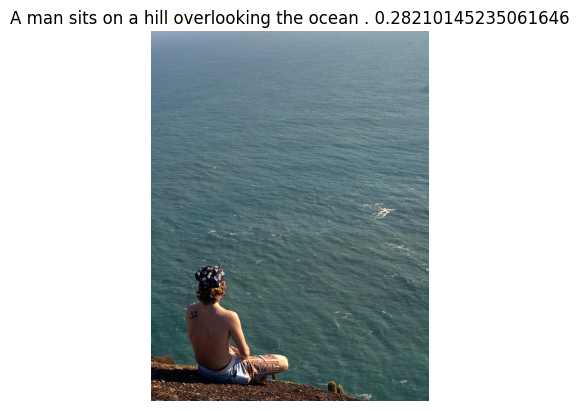

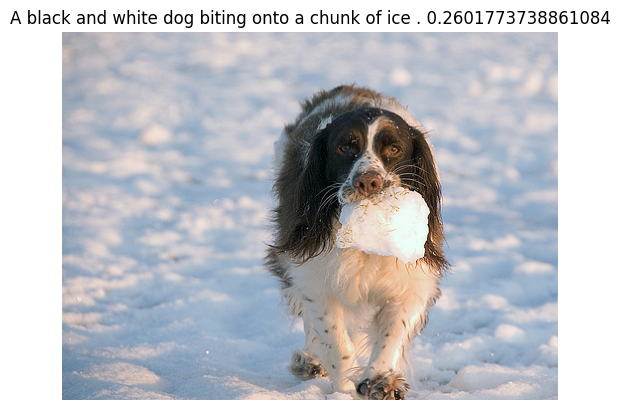

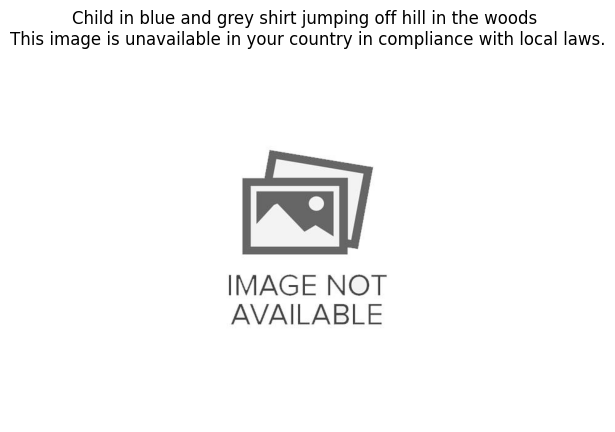

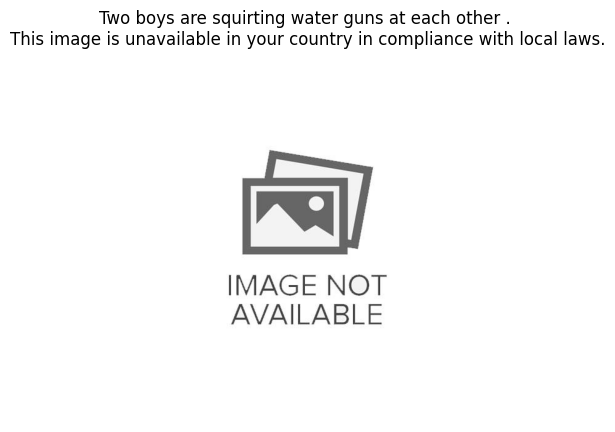

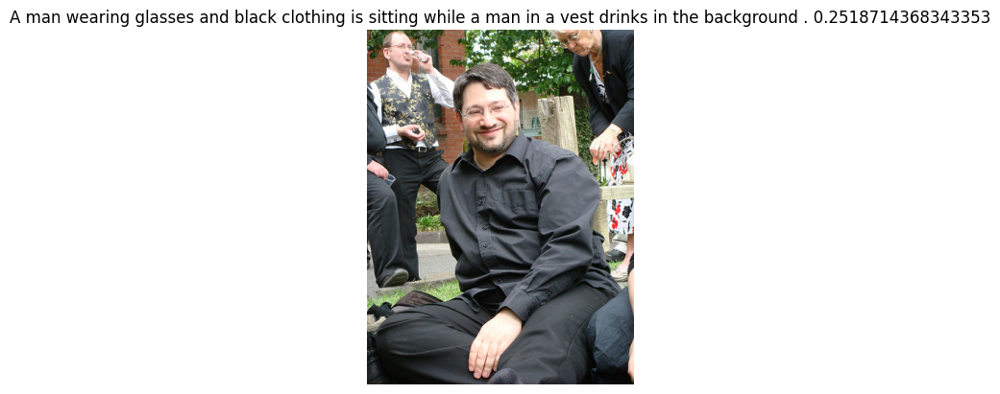

In [ ]:
view_result(labels, img_paths)

Результат намного лучше, видно куда нужно модели стремиться.

### CLIP

In [ ]:
# txt2imb = {file: 'unknown' for file in test_queries['query_text']}

# for i in tqdm.tqdm(test_queries['query_text']):
#     txt2imb[i] = get_text_embeddings(i)



In [ ]:
processor = CLIPProcessor.from_pretrained("openai/clip-vit-large-patch14")
model = CLIPModel.from_pretrained("openai/clip-vit-large-patch14").to(device)

def search_text_by_image(image_path, text_data, minor_keywords):
    image = Image.open(image_path).convert("RGB")
    image_inputs = processor(images=image, return_tensors="pt").to(device)

    filtered_texts = [text for text in text_data if not any(word in text.lower() for word in minor_keywords)]

    text_inputs = processor(text=filtered_texts, return_tensors="pt", padding=True, truncation=True).to(device)
    with torch.no_grad():
        outputs = model(**image_inputs, **text_inputs)
    logits = outputs.logits_per_image
    probs = logits.softmax(dim=-1)

    max_index = probs.argmax().item()
    best_text = filtered_texts[max_index]
    max_probability = probs.max().item()
    best_text = best_text + '\n' + str(max_probability)
    return image_path, best_text


In [ ]:
test_queries

,query_id,query_text,image
0,1177994172_10d143cb8d.jpg#0,"Two blonde boys , one in a camouflage shirt an...",1177994172_10d143cb8d.jpg
1,1177994172_10d143cb8d.jpg#1,Two boys are squirting water guns at each other .,1177994172_10d143cb8d.jpg
2,1177994172_10d143cb8d.jpg#2,Two boys spraying each other with water,1177994172_10d143cb8d.jpg
3,1177994172_10d143cb8d.jpg#3,Two children wearing jeans squirt water at eac...,1177994172_10d143cb8d.jpg
4,1177994172_10d143cb8d.jpg#4,Two young boys are squirting water at each oth...,1177994172_10d143cb8d.jpg
...,...,...,...
495,989851184_9ef368e520.jpg#0,A black dog has a dumbbell in his mouth .,989851184_9ef368e520.jpg
496,989851184_9ef368e520.jpg#1,A black dog has a dumbbell in his mouth lookin...,989851184_9ef368e520.jpg
497,989851184_9ef368e520.jpg#2,A black dog holding a weight in its mouth stan...,989851184_9ef368e520.jpg
498,989851184_9ef368e520.jpg#3,A black dog holds a small white dumbbell in it...,989851184_9ef368e520.jpg


In [ ]:
def process_images(image_paths, texts, minor_keywords):
    results = []
    for image_path in image_paths:
        result = search_text_by_image(image_path, texts, minor_keywords)
        results.append(result)
    return results


res = np.array(process_images(np.array(DIRECTORY + 'test_images/'+ test_queries['image'].sample(10, random_state=4)), np.array(test_queries['query_text']), minor_keywords))
paths = res[:, 0]
labels = res[:, 1]


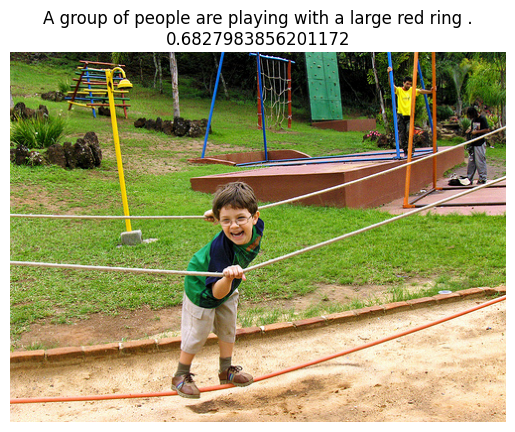

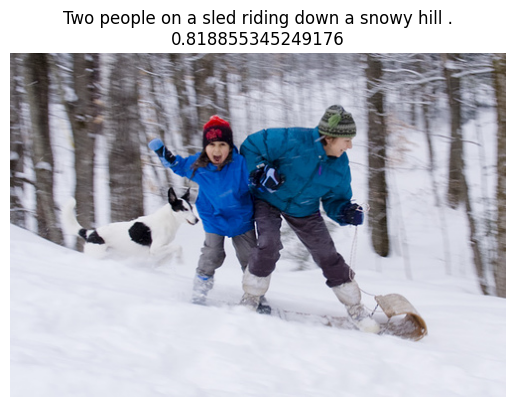

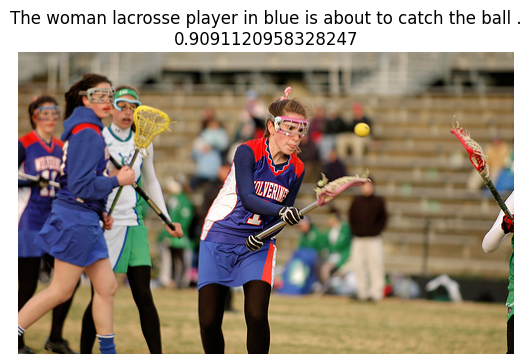

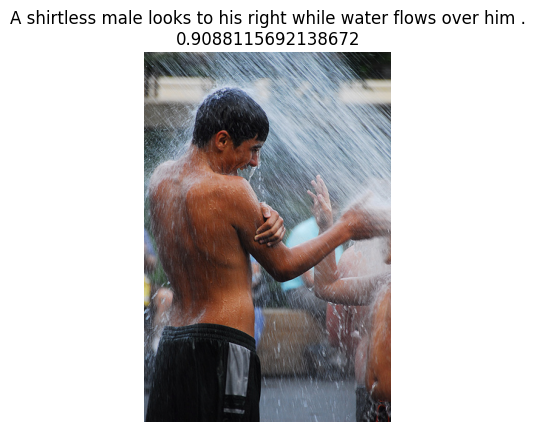

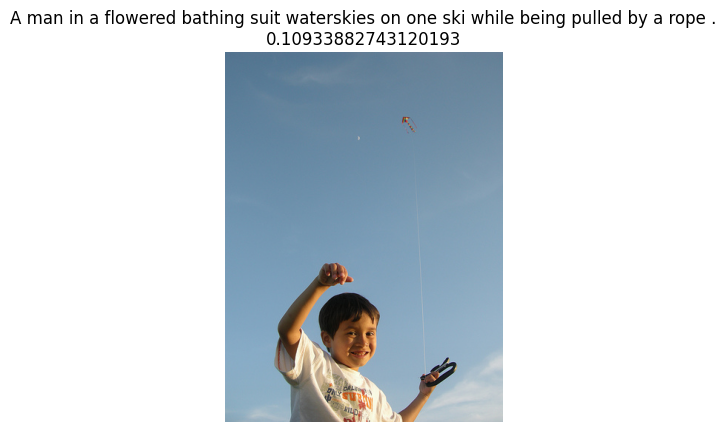

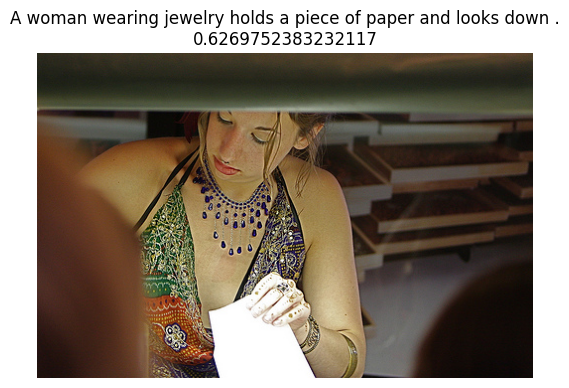

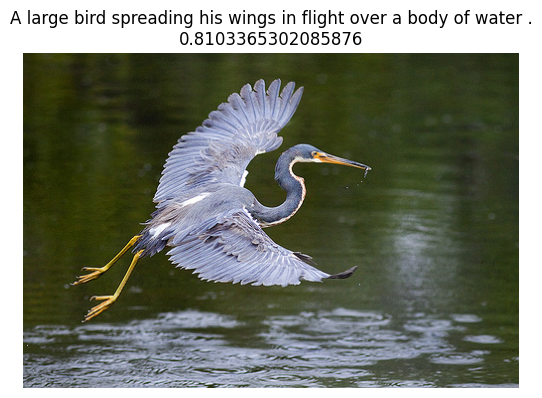

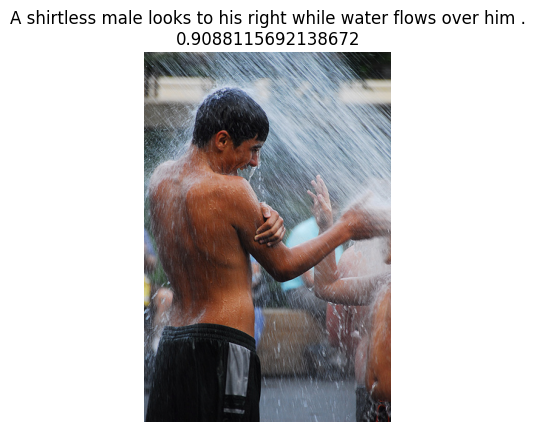

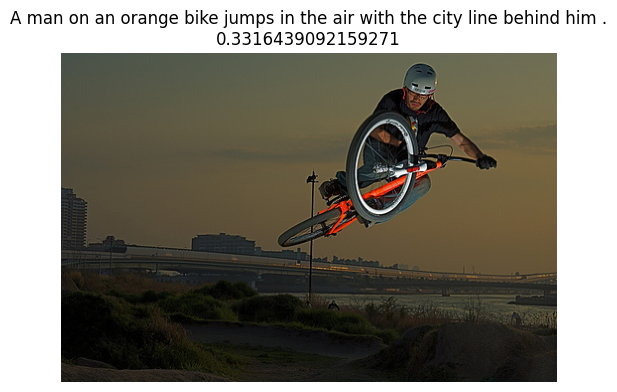

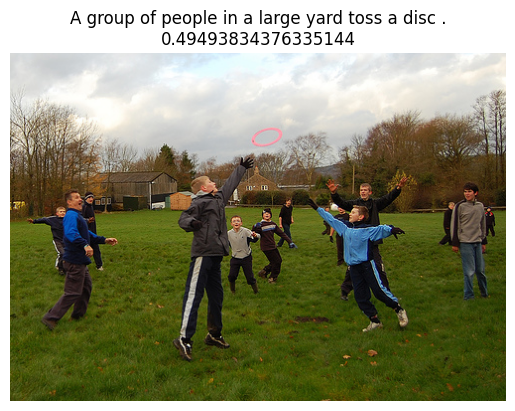

In [ ]:
view_result(labels, paths)

Как видно подготовленная модель Clip показывает очень хороший результат.

## 8. Выводы

- Jupyter Notebook открыт
- Весь код выполняется без ошибок
- Ячейки с кодом расположены в порядке исполнения
- Исследовательский анализ данных выполнен
- Проверены экспертные оценки и краудсорсинговые оценки
- Из датасета исключены те объекты, которые выходят за рамки юридических ограничений
- Изображения векторизованы
- Текстовые запросы векторизованы
- Данные корректно разбиты на тренировочную и тестовую выборки
- Предложена метрика качества работы модели
- Предложена модель схожести изображений и текстового запроса
- Модель обучена
- По итогам обучения модели сделаны выводы
- Проведено тестирование работы модели
- По итогам тестирования визуально сравнили качество поиска

Основной задачей стоял поиск изображения по запросу. В целом задача была решена, но из-за того, что демонстративный датасет слишком мал, добиться адекватного качества не получилось. Тем не менее, было испробавано несколько моделей. Для начала мы разбили изображение и текст на эмбеддинги и соединили их. Тестировали различные способы: EfficientNet-b7, VIT, Clip для получения эмбеддинга фотографии и DistilBert, Clip для получения эмбеддинга текста. Лучший результат ожидаемо показал Clip, так как он был создан для схожей задачи работы с текстом и изображением. Лучшей моделью стала модель градиентного бустинга из CatBoost.


Стоит подметить некоторые детали:
1) простой предобработки текста недостаточно, чтобы соблюсти все юридические нормы и нужно будет работать именно с изображением либо же строить нейронную сеть для текста.

2) нужен огромный датасет изображений и оценок